# Object Detection, Instance Segmentation and Person Keypoint Detection with Region Based Convolutional Neural Network.

You should have seen in our previous posts that Convolutional Neural Network is the state of the art for any computer vision task like

# [Image classification](https://www.learnopencv.com/pytorch-for-beginners-image-classification-using-pre-trained-models/)
   Image classification is the task where the main content of the image is identified amoung a set of classes. The input image is sent through a trained Convolutional Neural Network(CNN) and the network returns as the probability of the image belonging to each known class like dog, cat, bird, car,...,etc.
   
  ![](https://cdn-images-1.medium.com/max/1600/0*vGUfB562XtC6vvmL.png)
  Image Source: [AlexNet](https://papers.nips.cc/paper/4824-imagenet-classification-with-deep-convolutional-neural-networks.pdf) 

# [Semantic Segmentation](https://www.learnopencv.com/pytorch-for-beginners-semantic-segmentation-using-torchvision/)

  In Semantic Segmentation, every pixel of the image is classiifed into different known classes. A Fully Convolutional Neural Network can be used for this task where the input is an image and the output is a segmented image of the input.
  
  ![](http://slideplayer.com/slide/8902510/26/images/1/Fully+Convolutional+Networks+for+Semantic+Segmentation.jpg)


In this notebook we will look at another computer vision application called object detection 

# Object Localization

In addition to classify an image, we want to know where in the image the object is. So we want to classify the image as cat/dog/..etc and we want to draw a bounding box around the region of the object in the image.

 
 But Object localization is pretty simple, it classifies an image like image classiifcation and draw a bounding box around the classified image. So if more that 1 class is present in the image, it ignores the other class and classifies image as a single class and draw box around it.
 
 Now given an image, the model will return the probability of the content of the image belonging to different known classes and the model will also return 4 floating values of the coordinates of the bounding box.
 


# Object Detection
  
  Object Detection is the next step of Object Localization where the task remains the same(classification and bounding box) but obejct detection input images may have multiple known class objects in a single image and the task is to draw a bounding box around all the objects and classify each object.
  
  The main challenge here is that there might be a varying number of objects in every input image.


- ## Sliding Window Approach
  Sliding window is one of the oldest approach in object detection where the input image is split into multiple crops and each crop of the image is classified and if the crop contains a class, then the crop is decided as the bounding box. But this approach is never used in practice as each input image may have 1000s of such crops and each crop passing through the network for classification may take time.
  
- ## Region Proposal (RCNN)
  Image processing techniques are used to make list of proposed regions in the input image which are then sent through network for classification. But this is computationally more efficient than sliding window approach as only fewer potential crops which may contain the object is classified by the network.
  
  ![](https://cdn-images-1.medium.com/max/800/1*REPHY47zAyzgbNKC6zlvBQ.png)
  Image Source :  [Ross Girshick et al](https://arxiv.org/pdf/1311.2524.pdf)
  
  RCNN is better than slifding window, but its still computationally expensive as the network has to classify all the region proposals. It takes around 30-40s for inference of a single image.
  
  
- ## Fast Region Proposal (Fast RCNN)
  In fast RCNN, rather than getting region proposals and classifying each region proposals, the input image is sent into the CNN network which gives a feature map of the image. Again some region proposals are used by now we get the region proposals from the feature map of the image and these feature maps are classified. This reduces the computation as some of the CNN layers are common for the whole image. 
  
  ![](https://cdn-images-1.medium.com/max/800/1*0pMP3aY8blSpva5tvWbnKA.png)
  Image Source : [Ross Gishich](https://arxiv.org/pdf/1504.08083.pdf)
  

- ## Faster R-CNN
  The idea of Faster R-CNN is to use CNNs to propose potential region of interest and the network is called Region Proposal Network. After getting the region proposals , its just like Fast RCNN, we use every regions for classification.
![](https://www.researchgate.net/profile/Giang_Son_Tran/publication/324549019/figure/fig1/AS:649929152266241@1531966593689/Faster-R-CNN-Architecture-9.png)

# Instance Segmentation
  Instance Segmentation is a combination of 2 problems
  - Object Detection
  - Semantic Segmentation
  
![](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRmp4t9zSQ9DWyTuWv2OwK4Eq4ydaBbvl1FiaslP_y0etJ89n-5)
  
Mask RCNN uses 2 type of networks one like Faster RCNN for Object Detection and another fully convolutional network for Semantic Segmentation. The 1st model will get the bounding box and classify it and the second model is used on each of the region of interest for semantic segmentation. 
  
![](https://cdn-images-1.medium.com/max/1600/1*IWWOPIYLqqF9i_gXPmBk3g.png)
Image Source: [Mask R-CNN](https://arxiv.org/pdf/1703.06870.pdf)

# Object Detection, Instance Segmentation and Person Keypoint Detection in PyTorch

It is fine if you don't understand every detail of the models discussed above. If you want to learn more about all of these models and many more application and concepts of Deep Learning and Computer Vision indetail,  check out the official [Deep Learning and Computer Vision courses](https://opencv.org/courses/) by OpenCV.org. 

Now we will use pre trained models in PyTorch for
  - Object Detection
  - Instance Segmentation 
  - Person Keypoint Detection
  
  
  All the pretrained models in pytorch can be found in [torchvision.models](https://pytorch.org/docs/stable/torchvision/models.html)
  

# Object Detection with PyTorch

The pretrained Faster-RCNN ResNet-50 model we are going to use expects the input image tensor to be in the form ```[n, c, h, w]``` 
where 
- n is the number of images
- c is the number of channels , for RGB images its 3
- h is the height of the image
- w is the widht of the image




In [0]:
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()


COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic', 'light', 'fire', 'hydrant', 'N/A', 'stop',
    'sign', 'parking', 'meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports', 'ball',
    'kite', 'baseball', 'bat', 'baseball', 'glove', 'skateboard', 'surfboard', 'tennis',
    'racket', 'bottle', 'N/A', 'wine', 'glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot', 'dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted', 'plant', 'bed', 'N/A', 'dining', 'table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell',
    'phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy', 'bear', 'hair', 'drier', 'toothbrush'
]



def get_prediction(img_path, threshold):
  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  pred = model([img])
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
  pred_score = list(pred[0]['scores'].detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  return pred_boxes, pred_class
  


def obj_det_api(img_path, threshold=0.5, rect_th=3, text_size=3, text_th=3):
  boxes, pred_cls = get_prediction(img_path, threshold)
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  for i in range(len(boxes)):
    cv2.rectangle(img, boxes[i][0], boxes[i][1],color=(0, 255, 0), thickness=rect_th)
    cv2.putText(img,pred_cls[i], boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=text_th)
  plt.figure(figsize=(20,30))
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()
  
  
 

--2019-06-10 23:36:00--  https://www.wsha.org/wp-content/uploads/banner-diverse-group-of-people-2.jpg
Resolving www.wsha.org (www.wsha.org)... 104.198.7.33
Connecting to www.wsha.org (www.wsha.org)|104.198.7.33|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1923610 (1.8M) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>]   1.83M  1.56MB/s    in 1.2s    

2019-06-10 23:36:02 (1.56 MB/s) - ‘people.jpg’ saved [1923610/1923610]



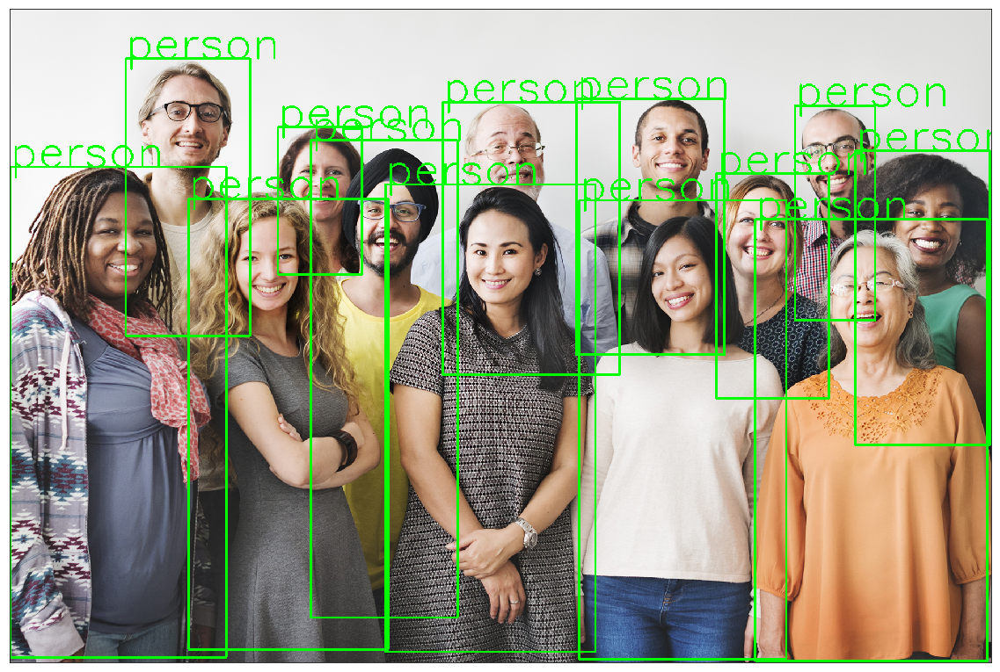

In [0]:
!wget https://www.wsha.org/wp-content/uploads/banner-diverse-group-of-people-2.jpg -O people.jpg
  
obj_det_api('/content/people.jpg', threshold=0.8)

--2019-06-10 23:33:46--  https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/10best-cars-group-cropped-1542126037.jpg
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2307387 (2.2M) [image/jpeg]
Saving to: ‘car.jpg’

car.jpg             100%[===================>]   2.20M  --.-KB/s    in 0.03s   

2019-06-10 23:33:46 (72.4 MB/s) - ‘car.jpg’ saved [2307387/2307387]



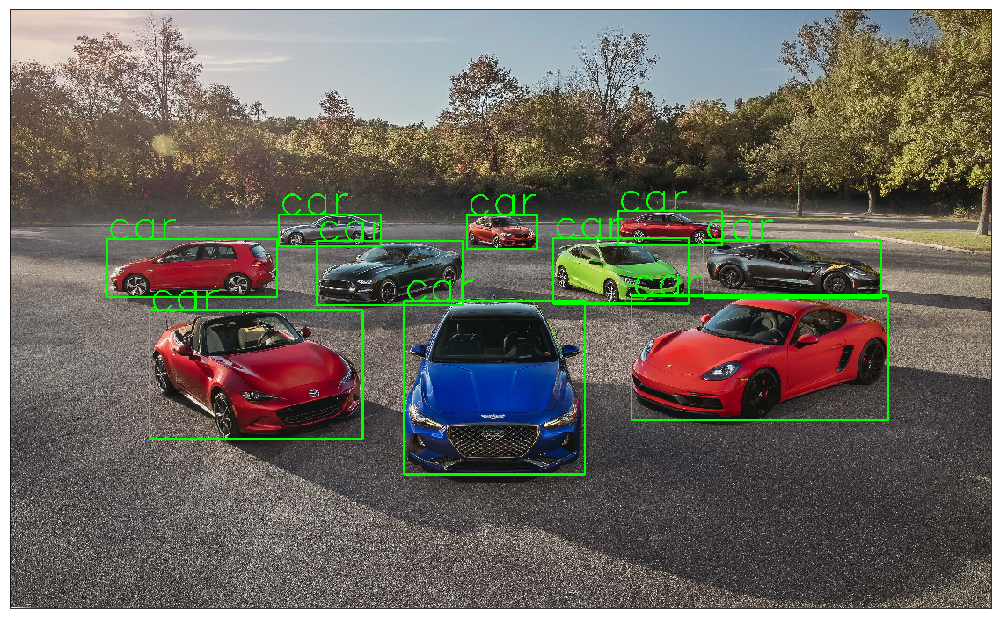

In [0]:
!wget https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/10best-cars-group-cropped-1542126037.jpg -O car.jpg
  
obj_det_api('/content/car.jpg', rect_th=6, text_th=5, text_size=5)

--2019-06-10 23:37:18--  https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.141.87, 104.18.82.97, 2606:4700::6812:5261, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.141.87|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 253264 (247K) [image/jpeg]
Saving to: ‘traffic.jpg’

traffic.jpg         100%[===================>] 247.33K  --.-KB/s    in 0.002s  

2019-06-10 23:37:18 (115 MB/s) - ‘traffic.jpg’ saved [253264/253264]



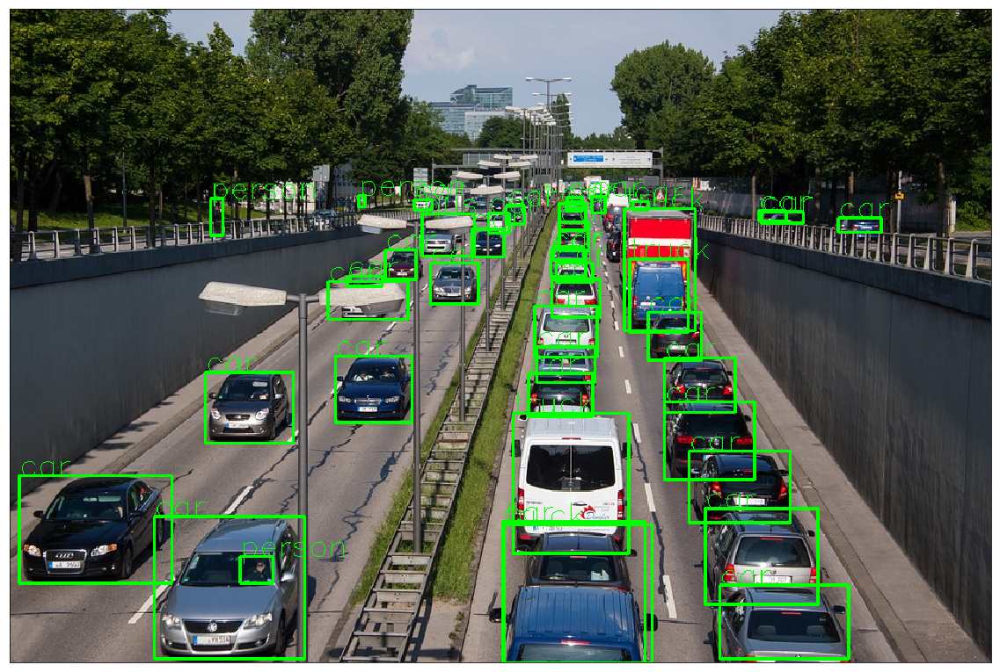

In [0]:
!wget https://cdn.pixabay.com/photo/2013/07/05/01/08/traffic-143391_960_720.jpg -O traffic.jpg
  
obj_det_api('/content/traffic.jpg', rect_th=2, text_th=1, text_size=1)

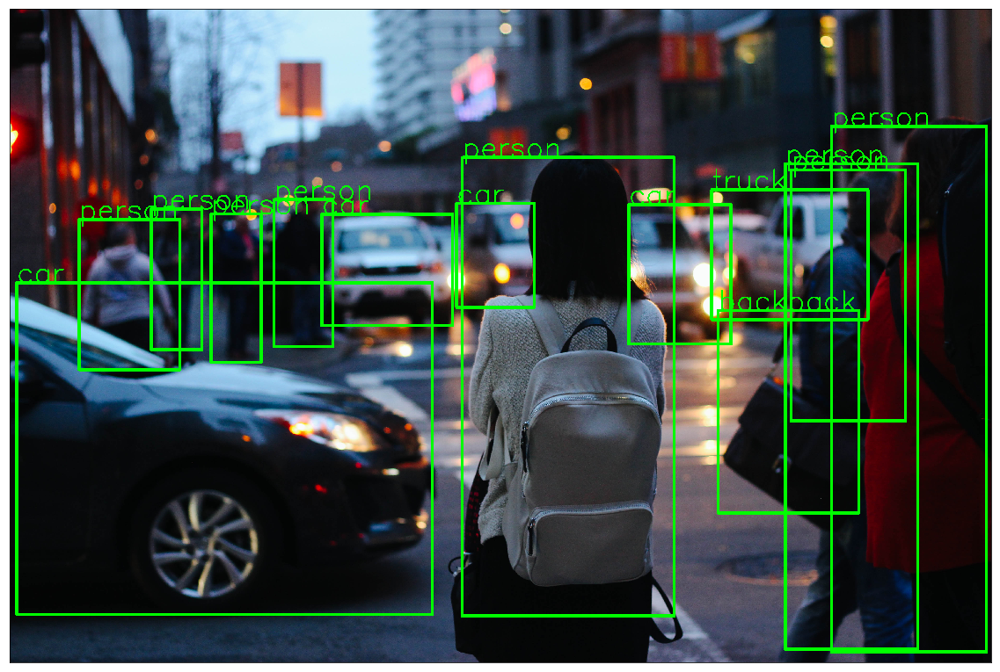

In [0]:
!wget https://images.unsplash.com/photo-1458169495136-854e4c39548a -O girl_cars.jpg
  
obj_det_api('/content/girl_cars.jpg', rect_th=15, text_th=7, text_size=5, threshold=0.8)  

# Person Keypoint Detection

In [0]:
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2

model = torchvision.models.detection.keypointrcnn_resnet50_fpn(pretrained=True)
model.eval()

COCO_PERSON_KEYPOINT_NAMES = [
    'nose',
    'left_eye',
    'right_eye',
    'left_ear',
    'right_ear',
    'left_shoulder',
    'right_shoulder',
    'left_elbow',
    'right_elbow',
    'left_wrist',
    'right_wrist',
    'left_hip',
    'right_hip',
    'left_knee',
    'right_knee',
    'left_ankle',
    'right_ankle'
]


def get_prediction(img_path):
  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  pred = model([img])
#   pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
  pred_key = [i.tolist() for i in list(pred[0]['keypoints'].detach().numpy())]
  key_score = [i.tolist() for i in list(pred[0]['keypoints_scores'].detach().numpy())]
  return pred_key,key_score
  
  


def keypoint_api(img_path, threshold=0, dot_size=20):
  pred_key, key_score = get_prediction(img_path)
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  for i in range(len(pred_key)):
    for j in range(len(pred_key[0])):
      if key_score[i][j] > threshold:
        cv2.circle(img,(int(pred_key[i][j][0]), int(pred_key[i][j][1])), dot_size, (255,0,0), -1)
  plt.figure(figsize=(20,30))
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()
  
  
 

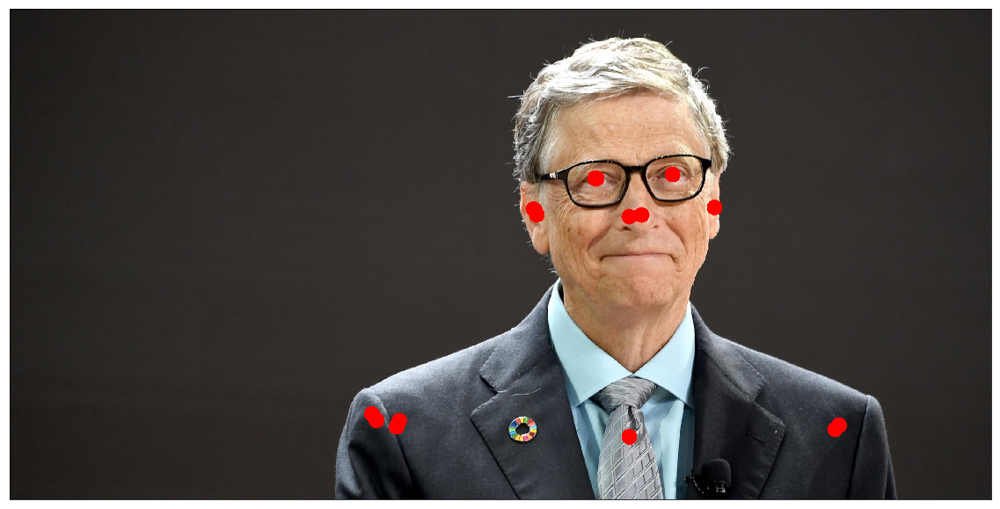

In [0]:
keypoint_api('/content/person.jpg')

--2019-06-11 01:01:07--  https://images.unsplash.com/photo-1502791451862-7bd8c1df43a7
Resolving images.unsplash.com (images.unsplash.com)... 151.101.2.208, 151.101.66.208, 151.101.130.208, ...
Connecting to images.unsplash.com (images.unsplash.com)|151.101.2.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2691450 (2.6M) [image/jpeg]
Saving to: ‘person2.jpg’

person2.jpg         100%[===================>]   2.57M  --.-KB/s    in 0.02s   

2019-06-11 01:01:07 (109 MB/s) - ‘person2.jpg’ saved [2691450/2691450]



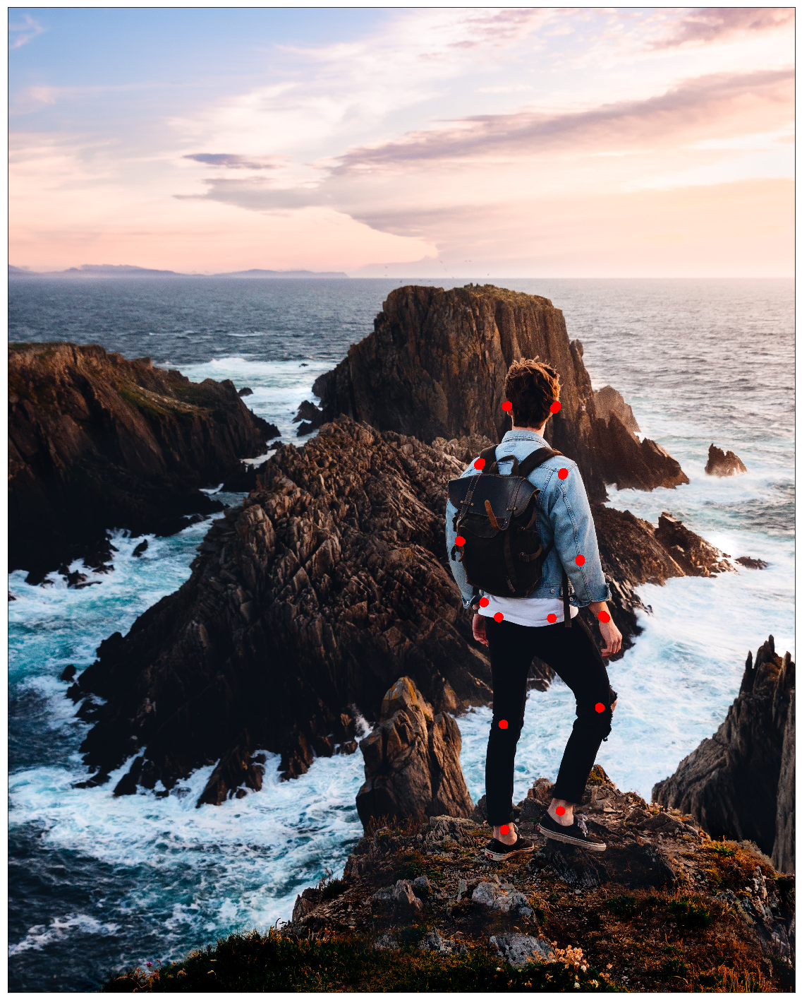

In [0]:
!wget https://images.unsplash.com/photo-1502791451862-7bd8c1df43a7 -O person2.jpg
keypoint_api('/content/person2.jpg', threshold=5)

--2019-06-11 01:03:27--  https://images.unsplash.com/photo-1505150892987-424388901632
Resolving images.unsplash.com (images.unsplash.com)... 151.101.2.208, 151.101.66.208, 151.101.130.208, ...
Connecting to images.unsplash.com (images.unsplash.com)|151.101.2.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13438846 (13M) [image/jpeg]
Saving to: ‘person3.jpg’

person3.jpg         100%[===================>]  12.82M  --.-KB/s    in 0.07s   

2019-06-11 01:03:27 (185 MB/s) - ‘person3.jpg’ saved [13438846/13438846]



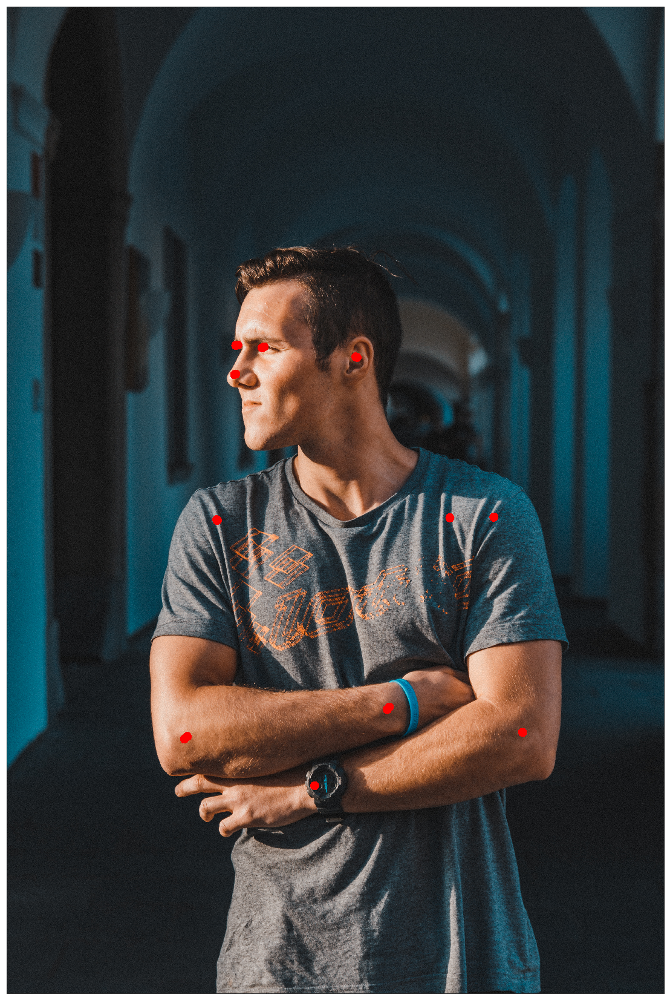

In [0]:

!wget https://images.unsplash.com/photo-1505150892987-424388901632 -O person3.jpg
keypoint_api('/content/person3.jpg', threshold=5, dot_size=25)

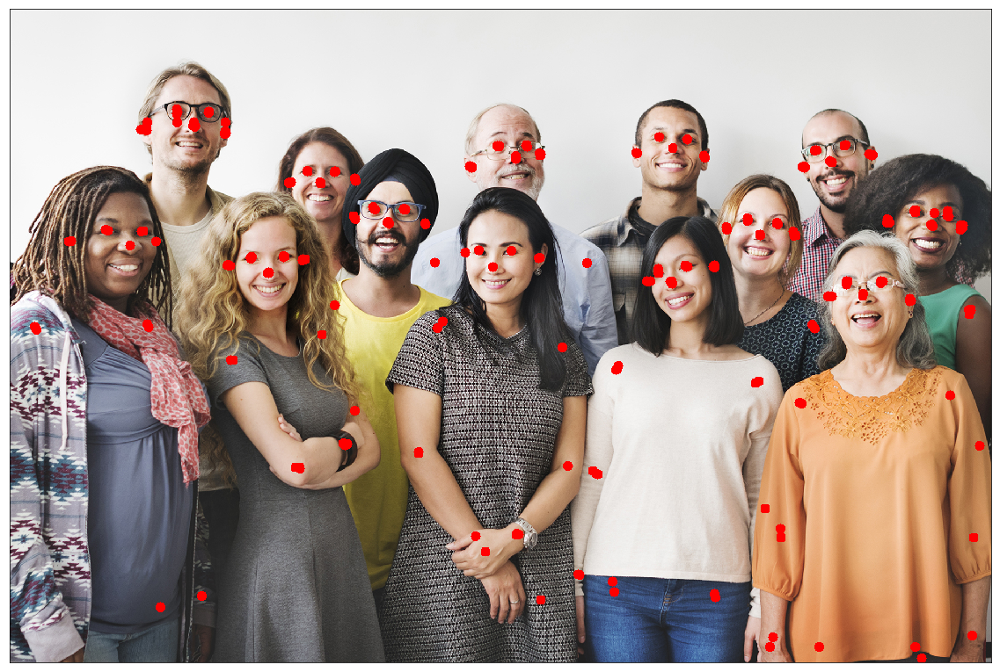

In [0]:
keypoint_api('/content/people.jpg', threshold=5, dot_size=10)

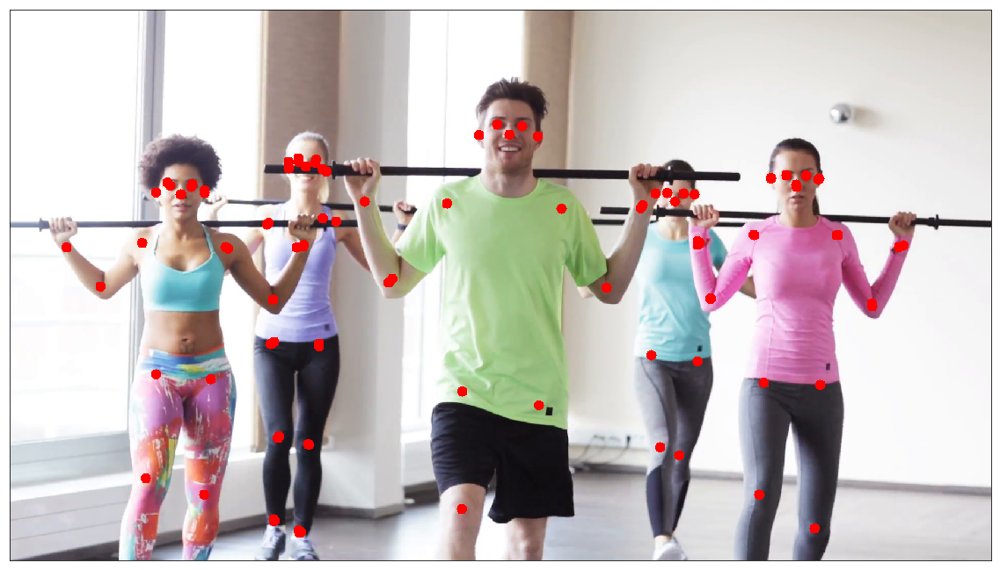

In [0]:
# !wget https://d2v9y0dukr6mq2.cloudfront.net/video/thumbnail/4ZrVLdVKeijzurndz/fitness-sport-training-gym-and-lifestyle-concept-group-of-people-exercising-with-bars-in-gym_ewxjxbt2l__F0000.png -O exercise.jpg
keypoint_api('/content/exercise.jpg', threshold=6, dot_size=10)

# Instance Segmentation

In [0]:
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2
import random

model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
model.eval()


def random_colour_masks(image):
  r = np.zeros_like(image).astype(np.uint8)
  g = np.zeros_like(image).astype(np.uint8)
  b = np.zeros_like(image).astype(np.uint8)
  r[image == 1] = random.randrange(0,255)
  g[image == 1] = random.randrange(0,255)
  b[image == 1] = random.randrange(0,255)
  coloured_mask = np.stack([r, g, b], axis=2)
  return coloured_mask


def get_prediction(img_path):
  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  pred = model([img])
  masks = (pred[0]['masks']>0.5).squeeze().detach().cpu().numpy()
  return masks
  


def instance_segmentation_api(img_path):
  masks = get_prediction(img_path)
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  for i in range(len(masks)):
    rgb_mask = random_colour_masks(masks[i])
    img = cv2.addWeighted(img, 1, rgb_mask, 0.8, 0)
  plt.figure(figsize=(20,30))
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()
    
    
    
  

  
 

In [0]:
img = Image.open('/content/person.jpg')
transform = T.Compose([T.ToTensor()])
img = transform(img)
pred = model([img])

In [0]:
pred[0]

{'boxes': tensor([[ 755.1402,   67.5177, 2291.9255, 1236.0547],
         [1485.3538,  925.7294, 1669.5149, 1246.0184]], grad_fn=<StackBackward>),
 'labels': tensor([ 1, 32]),
 'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]]], grad_fn=<UnsqueezeBackward0>),
 'scores': tensor([0.9994, 0.9983], grad_fn=<IndexBackward>)}

In [0]:
masks = (pred[0]['masks']>0.5).squeeze().detach().cpu().numpy()
masks.shape

(2, 1250, 2500)

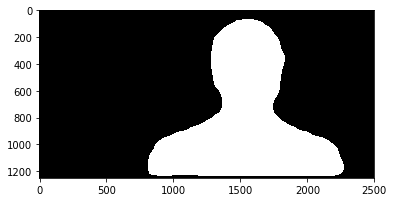

In [0]:
plt.imshow(masks[0], cmap='gray')
plt.show()

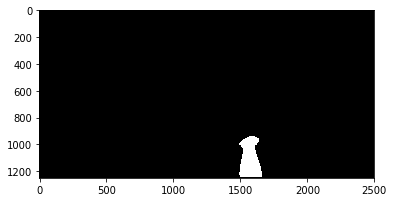

In [0]:
plt.imshow(masks[1], cmap='gray') 
plt.show()

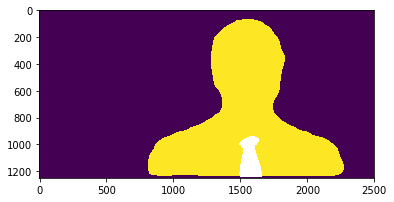

In [0]:
import numpy.ma as ma

combined_masks = ma.masked_array(masks[0] > 0, masks[1])
plt.imshow(combined_masks)
plt.show()

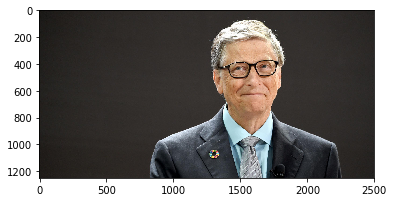

In [0]:
import matplotlib.image as mpimg
img=mpimg.imread('/content/person.jpg')
plt.imshow(img)
plt.show()

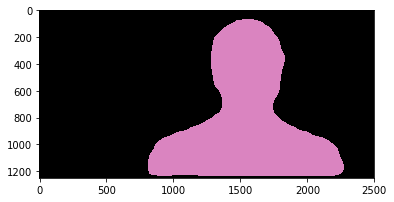

In [0]:
rgb = decode_segmap(masks[0])
rgb2 = decode_segmap(masks[1])
plt.imshow(rgb); plt.show()

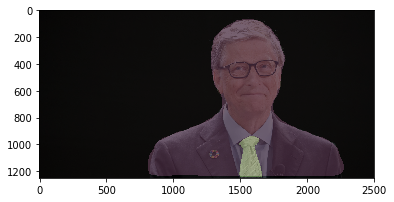

In [0]:
com1 = cv2.addWeighted(img, 0.5, rgb, 0.5, 0)
com2 = cv2.addWeighted(com1, 0.5, rgb2, 0.5, 0)

plt.imshow(com2)

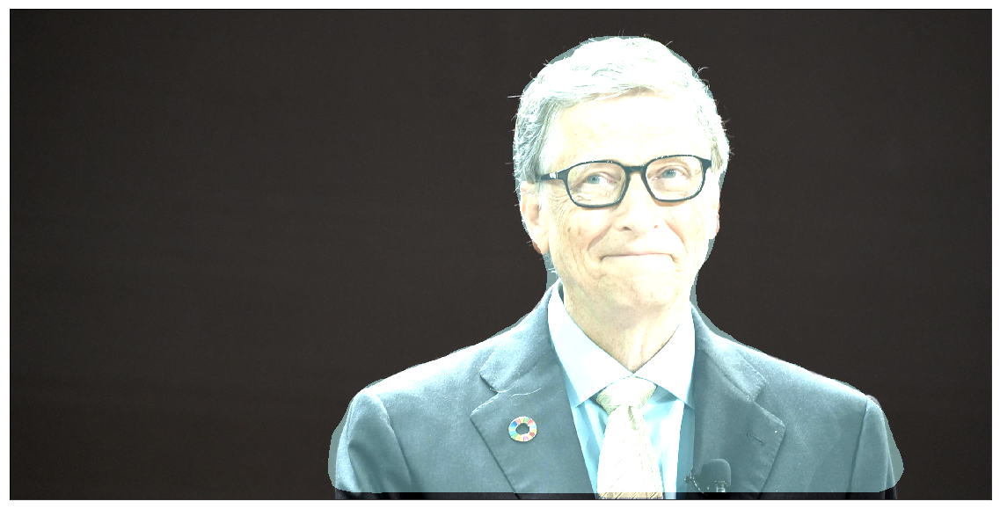

In [0]:
instance_segmentation_api('/content/person.jpg')

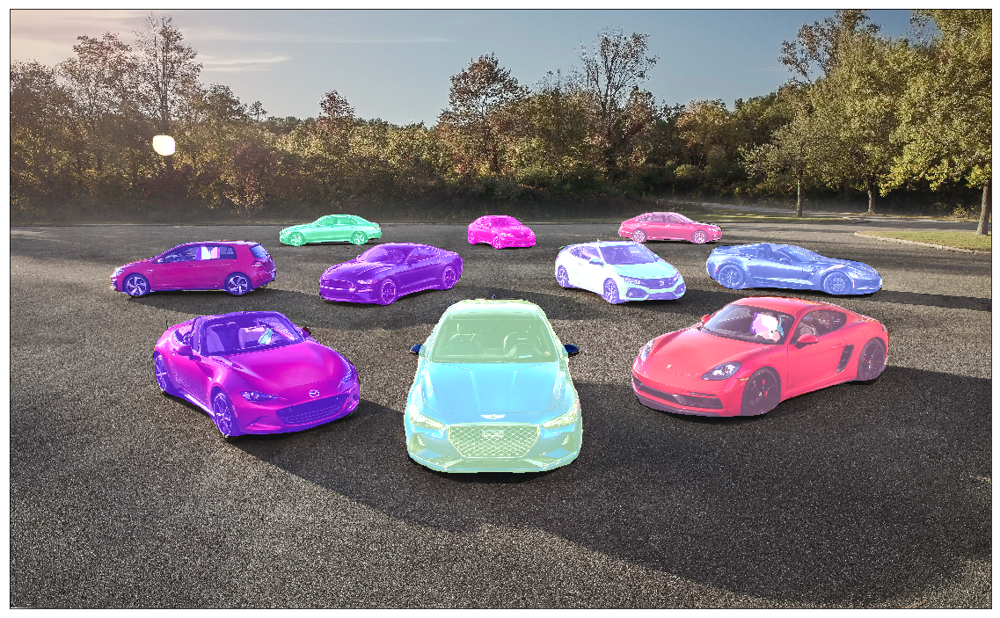

In [0]:
instance_segmentation_api('/content/car.jpg')

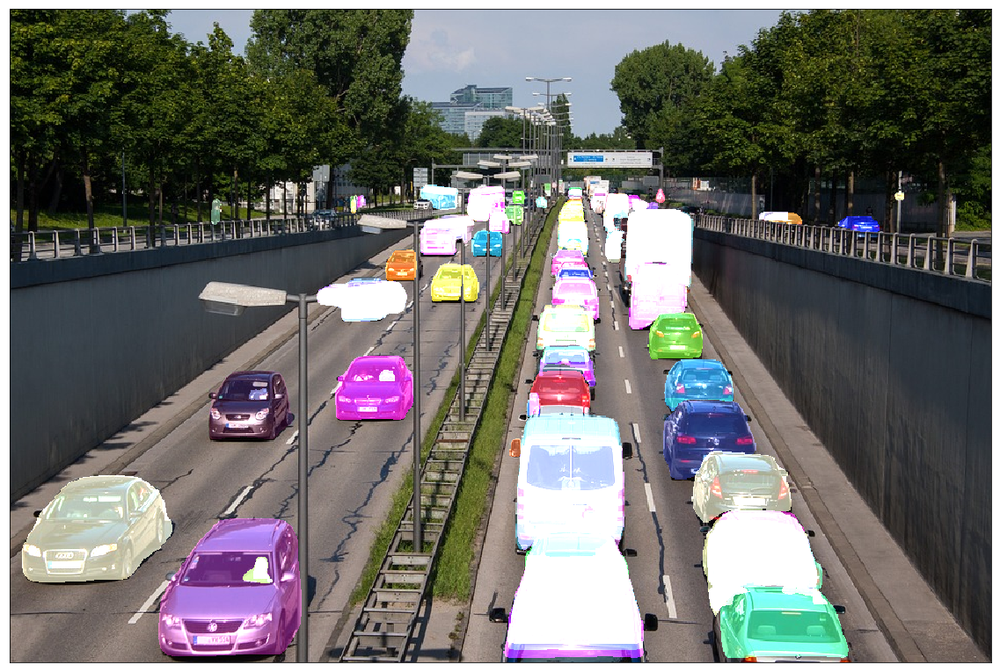

In [0]:
instance_segmentation_api('/content/traffic.jpg')